In [2]:
import sys
import math
import time
sys.path.append('/Users/vdk/GeneveWork/Code/calibpipe-main-calibpipe/')
import numpy as np
import pandas as pd
import scipy as sc
import matplotlib.pyplot as plt
from seaborn import histplot
import astropy.units as u
from astropy.io import ascii
from astropy.coordinates import SkyCoord
from astropy.table import Table
from astropy.time import Time
from ctapipe.io import EventSource, EventSeeker
from ctapipe.image.cleaning import tailcuts_clean
from ctapipe.image.muon import MuonRingFitter, MuonIntensityFitter
from traitlets.config import Config
from ctapipe.image import ImageProcessor
from ctapipe.image.muon import MuonProcessor
from ctapipe.visualization import CameraDisplay
from ctapipe.instrument import CameraGeometry
from ctapipe.calib import CameraCalibrator
from traitlets.config.loader import Config, FileConfigLoader, JSONFileConfigLoader
from calibpipe.throughput import MuonCalibrator
import h5py
from astropy.io import fits






In [2]:
# Read all energies of the simulation
energies_all = []
counter = 0
for k in range(1,11):
    filename = f'/Users/vdk/output_lst1_12Septv1/corsika_theta_0.0_az_180.0_run{k}.simtel.gz'
    source = EventSource(filename)
    event_iterator = iter(source)
    keks = k*1000
    for i,j in enumerate(event_iterator):
        counter += 1
        energies_all.append(j.simulation.shower.energy)

/Users/vdk/mambaforge/envs/cta/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/vdk/mambaforge/envs/cta/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/vdk/mambaforge/envs/cta/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/vdk/mambaforge/envs/cta/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use 

TypeError: 'NoneType' object is not iterable

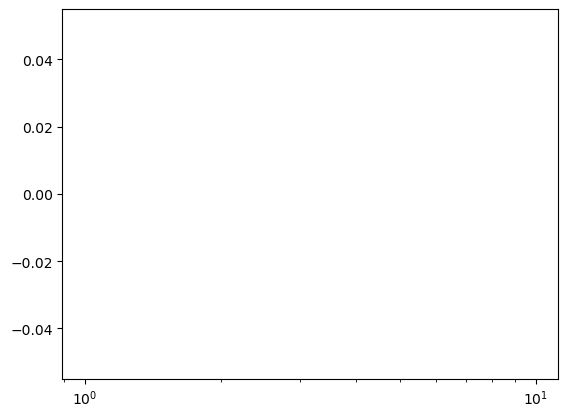

In [3]:
histplot(energies_all, log_scale = True, bins = 45)

In [57]:
# Create event container with all events
event_container = np.array([])
for k in range(1,2):
    filename = f'/Users/vdk/output_lst1_12Septv1/corsika_theta_0.0_az_180.0_run{k}.simtel.gz'
    source = EventSource(filename)
    event_iterator = iter(source)
    for i,j in enumerate(event_iterator):
        event_container = np.append(event_container, j)

In [62]:
event_container[0].simulation.shower.energy.to_value()

0.017510639503598213

In [ ]:
###
### To calibrate events and process muon rings
###
int_cut = 0.3
min_pixel = 80
muons = []

muon_processor_config = Config({"MuonProcessor": 
                                {"RingQuery": 
                                 {"quality_criteria" : [["intensity_check",f"np.abs(parameters.intensity_ratio - 1) < {int_cut}"],
                                                        ["ring_containment", "parameters.containment > 0.5"],
                                                        ["ring_completeness", "parameters.completeness > 0.5"]]}}})


for k in range(1,11):
    filename = f'/Users/vdk/output_lst1_12Septv1/corsika_theta_0.0_az_180.0_run{k}.simtel.gz'
    source = EventSource(filename)
    event_iterator = iter(source)
    for i,event in enumerate(event_iterator):           
        image_processor = ImageProcessor(source.subarray)
        muon_processor = MuonProcessor(source.subarray, config = muon_processor_config)
        calib = CameraCalibrator(image_extractor_type="GlobalPeakWindowSum",subarray = source.subarray)
        calib(event)
        image_processor(event)
        muon_processor(event)
        if not np.isnan(event.muon.tel[1].efficiency.optical_efficiency):
            muons.append(event)

# optical efficiency of muons           
opt_eff = []
for muon_event in muons:
    opt_eff.append(muon_event.muon.tel[1].efficiency.optical_efficiency)        

In [ ]:
# Not cleaned dataset
print(np.mean(opt_eff))
print(np.std(opt_eff))
print(len(opt_eff))

In [ ]:
####  NEW CLEANING NEW CLEANING NEW CLEANING
####
####
####

muon_processor_config = Config({"MuonProcessor": 
                                {"RingQuery": 
                                 {"quality_criteria" : [["intensity_check",f"np.abs(parameters.intensity_ratio - 1) < {int_cut}"],
                                                        ["ring_containment", "parameters.containment > 0.5"],
                                                        ["ring_completeness", "parameters.completeness > 0.5"]]}}})

muon_processor_config_2 = Config({"MuonProcessor":
                                {"ImageParameterQuery" :
                                 {"quality_criteria" : [["min_pixels", f"dl1_params.morphology.n_pixels < {min_pixel}"],
                                                        ["min_intensity", "dl1_params.hillas.intensity > 500"]]}}})

int_cut = 0.2
min_pixel = 200
muons_cleaned = []
tels = 1

for k in range(1,11):
    filename = f'/Users/vdk/output_lst1_12Septv1/corsika_theta_0.0_az_180.0_run{k}.simtel.gz'
    source = EventSource(filename)
    event_iterator = iter(source)
    for i,event in enumerate(event_iterator): 
        image_processor = ImageProcessor(source.subarray)
        muon_processor = MuonProcessor(source.subarray, config = muon_processor_config_2)
        calib = CameraCalibrator(image_extractor_type="GlobalPeakWindowSum",subarray = source.subarray)
        pixel_mask = []
        for k,l in enumerate(event.r0.tel[tels].waveform[1]):
            if np.argmax(l) in range(16,40): 
                pixel_mask.append(True)
            else:
                pixel_mask.append(False)
        working_wave = event.r1.tel[tels].waveform.copy()
        for k,l in enumerate(working_wave):
            if pixel_mask[k]:
                #working_wave[k] = np.zeros(40)     
                working_wave[k] = np.mean(event.r1.tel[tels].waveform, axis = 0)
        event.r1.tel[tels].waveform = working_wave
    
        calib(event)
        image_processor(event)
        muon_processor(event)
        if not np.isnan(event.muon.tel[tels].efficiency.width):
            muons_cleaned.append(event)
      


In [ ]:
# Processing of cleaned images, to choose proper muon rings
true_muons_cleaned = []

for event in muons_cleaned:
    if event.dl1.tel[tels].parameters.morphology.n_pixels > 30 and abs(event.muon.tel[tels].parameters.intensity_ratio - 1) < 0.3 and event.muon.tel[tels].parameters.completeness > 0.4 and event.muon.tel[tels].parameters.mean_squared_error.to_value() < 0.01:
        print(event.index.event_id)
        plt.figure(figsize = (9,6))
        camgeom = source.subarray.tel[tels].camera.geometry
        title=f"CleanedRing{event.index.event_id}_optEff{round(event.muon.tel[tels].efficiency.optical_efficiency,3)}_width{round(event.muon.tel[tels].efficiency.width.to_value(),3)}"
        disp = CameraDisplay(camgeom,title=title)
        disp.image = event.simulation.tel[tels].true_image
        disp.cmap = plt.cm.RdBu_r
        disp.add_colorbar()
        disp.set_limits_percent(95)
        #plt.show()
        true_muons_cleaned.append(event)
        
plt.close()

cleaned_opt_eff = []
for event in true_muons_cleaned:
    cleaned_opt_eff.append(event.muon.tel[1].efficiency.optical_efficiency)

In [ ]:
# Cleaned dataset
print(np.mean(cleaned_opt_eff))
print(np.std(cleaned_opt_eff))
print(len(cleaned_opt_eff))

In [ ]:
cleaned_completeness = []
for i in true_muons_cleaned:
    cleaned_completeness.append(i.muon.tel[1].parameters.completeness)

completeness = []
for i in muons:
    completeness.append(i.muon.tel[1].parameters.completeness)

plt.hist(completeness,bins = 7, label = 'completeness of muon rings', histtype = 'step')
plt.hist(cleaned_completeness,bins = 7, alpha = 1, label = 'completeness of cleaned muon rings', histtype = 'step')
plt.xlabel("counts")
plt.ylabel("completeness")
plt.legend()

Lets work with hdf5 files

In [3]:
filename = '/Users/vdk/Downloads/DL1_datacheck_20220628.h5'
fi = h5py.File(filename, 'r')
keys = list(fi.keys())

def printname(name):
    print(name)

# Show all included tables
fi.visit(printname)

cosmics
cosmics/_i_table
cosmics/_i_table/altitude
cosmics/_i_table/altitude/abounds
cosmics/_i_table/altitude/bounds
cosmics/_i_table/altitude/indices
cosmics/_i_table/altitude/indicesLR
cosmics/_i_table/altitude/mbounds
cosmics/_i_table/altitude/mranges
cosmics/_i_table/altitude/ranges
cosmics/_i_table/altitude/sorted
cosmics/_i_table/altitude/sortedLR
cosmics/_i_table/altitude/zbounds
cosmics/_i_table/azimuth
cosmics/_i_table/azimuth/abounds
cosmics/_i_table/azimuth/bounds
cosmics/_i_table/azimuth/indices
cosmics/_i_table/azimuth/indicesLR
cosmics/_i_table/azimuth/mbounds
cosmics/_i_table/azimuth/mranges
cosmics/_i_table/azimuth/ranges
cosmics/_i_table/azimuth/sorted
cosmics/_i_table/azimuth/sortedLR
cosmics/_i_table/azimuth/zbounds
cosmics/_i_table/elapsed_time
cosmics/_i_table/elapsed_time/abounds
cosmics/_i_table/elapsed_time/bounds
cosmics/_i_table/elapsed_time/indices
cosmics/_i_table/elapsed_time/indicesLR
cosmics/_i_table/elapsed_time/mbounds
cosmics/_i_table/elapsed_time/mra

In [11]:
for item in fi['runsummary/_i_table/elapsed_time']:
    print(item)

abounds
bounds
indices
indicesLR
mbounds
mranges
ranges
sorted
sortedLR
zbounds


Now Fits format

In [36]:
# Test table we received as result of script lstchain_dl1_muon_analysis.py
filename_fits = '~/folder_for_test/test_table.fits'
hdul = fits.open(filename_fits)
hdul.info()
#hdul[1].data

Filename: /Users/vdk/folder_for_test/test_table.fits
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  PRIMARY       1 PrimaryHDU       4   ()      
  1                1 BinTableHDU     54   400R x 23C   [K, D, D, E, E, D, D, D, D, L, D, D, D, D, D, D, D, D, D, K, D, D, D]   


In [37]:
# element number 10 is muon efficiency, so in such way we can check it
for i in range(len(hdul[1].data)):
    if not np.isnan(hdul[1].data[i][10]):
        print(hdul[1].data[i])

(356901, nan, 0.05740939825773239, 1950.4622, 0.0, -0.485533044224544, -0.7534992660540236, 1.1241403947926274, 0.08592060769419523, True, 0.15096342856397804, 1.0, 0.5, 9.109971241492593, 5.257771423500476, 7.439584375423392, 0.06152908624787521, 0.22893880326105215, -0.41243680419867257, 435, 1.3237216216345176, nan, nan)
(5915705, nan, 0.3354828655719757, 2999.3745, 0.0, 0.5934349223679676, 0.3996200202961702, 1.1058840939024943, 0.08891400469348336, True, 0.2402473356324124, 1.0, 0.7, 5.203819811736857, 1.82745631404444, 4.872385868677082, 0.07084032238829022, -0.052674380783226234, -0.3711565033216937, 422, 1.3085469862994026, nan, nan)
(10758305, nan, 0.2364523559808731, 1815.5028, 0.0, 0.7522668091296587, 1.3099967387357414, 1.1877262791822987, 0.035395914279113115, False, 0.14126767784997618, 0.6314731172601541, 0.5666666666666667, 0.002249300283346578, 0.0022492767225287696, 1.0295151928647379e-05, 0.034575203056366015, 0.04200981303349766, -0.2292300526854949, 334, 1.24691832

In [8]:
counter = 100
np.savetxt(f'/Users/vdk/values.txt', [counter])

In [19]:
int_cut = 0.3

muon_processor_config = Config({"MuonProcessor": 
                                {"RingQuery": 
                                 {"quality_criteria" : [["intensity_check",f"np.abs(parameters.intensity_ratio - 1) < {int_cut}"],
                                                        ["ring_containment", "parameters.containment > 0.5"],
                                                        ["ring_completeness", "parameters.completeness > 0.5"]]}}})
muons = []

for run in range(1001, 1100):
    crab_sim_file = f'/Users/vdk/crab_sim/corsika_theta_16.087_az_108.090_run{run}.simtel.gz'
    source = EventSource(crab_sim_file)
    event_iterator = iter(source)
    for i,event in enumerate(event_iterator):           
        image_processor = ImageProcessor(source.subarray)
        muon_processor = MuonProcessor(source.subarray, config = muon_processor_config)
        calib = CameraCalibrator(image_extractor_type="GlobalPeakWindowSum",subarray = source.subarray)
        calib(event)
        image_processor(event)
        muon_processor(event)
        if not np.isnan(event.muon.tel[1].efficiency.optical_efficiency):
            muons.append(event)

/Users/vdk/mambaforge/envs/cta/lib/python3.11/site-packages/ctapipe/image/pixel_likelihood.py:98: RuntimeWarning: invalid value encountered in log
  neg_log_l = np.log(theta + EPSILON) + (image - prediction) ** 2 / theta


In [28]:
opt_eff = []
for event in muons:
    opt_eff.append(event.muon.tel[1].efficiency.optical_efficiency)

np.mean(opt_eff)

0.30616848173101696

3469709
5734904
1440909
3966800
1699902
3317203
1905000
1765107
4506608
1399704
4943509
4942908
335509
430307
967205
2807206
2814607
1899905
1043305
2518407
5355109
2082303


/var/folders/_p/3fmt5jz5231_9gxtm8xt76p00000gn/T/ipykernel_10045/3689849225.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize = (9,6))


3143708
3179504
3646505
184102
3136207
3969604


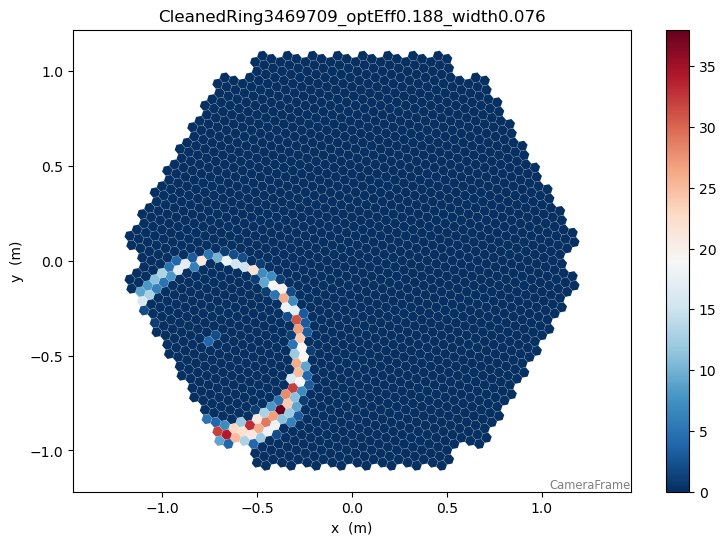

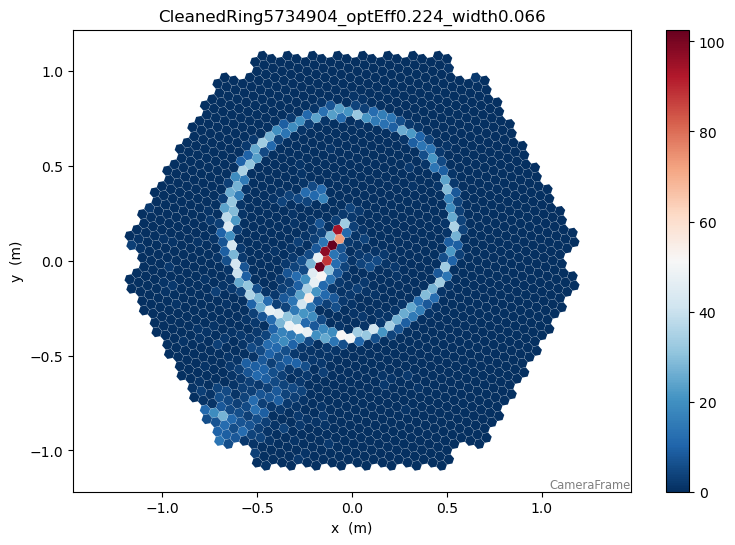

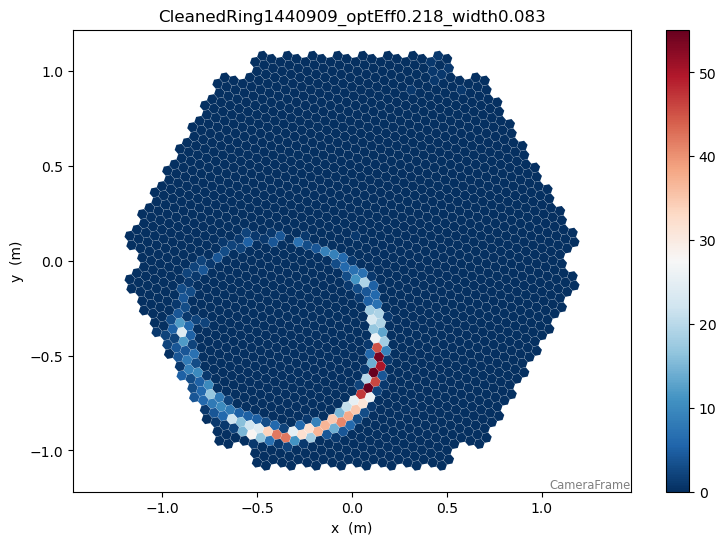

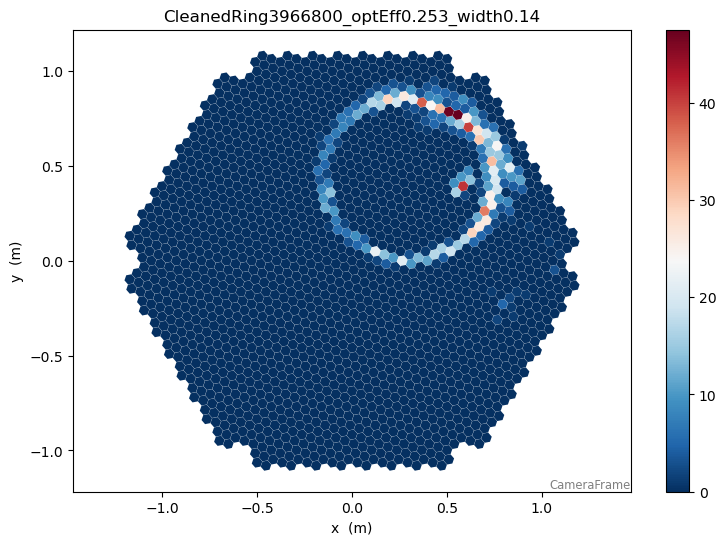

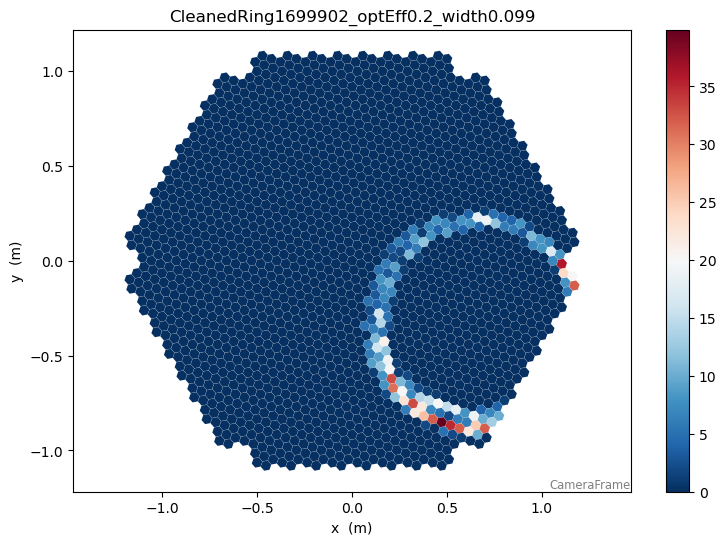

...

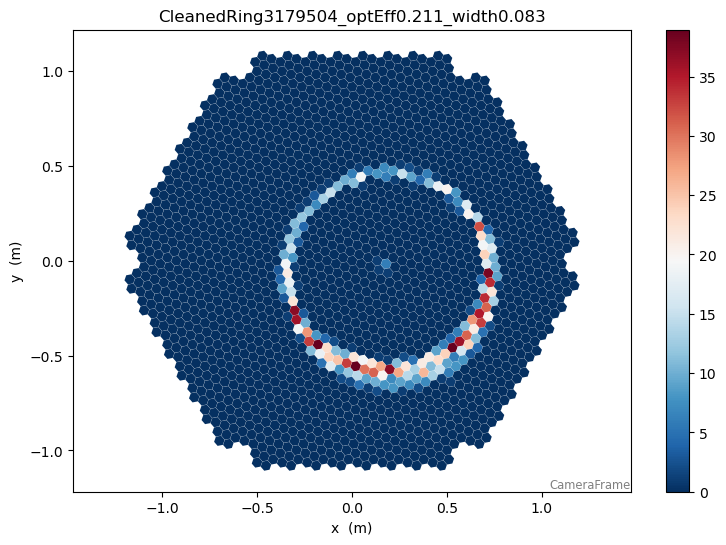

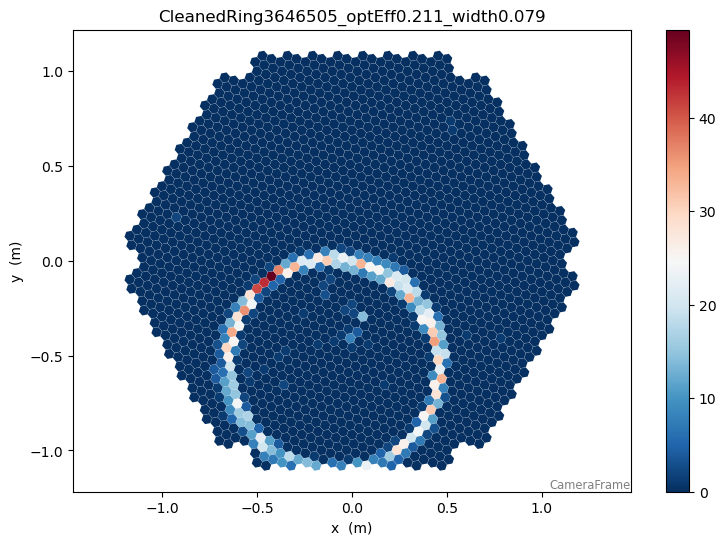

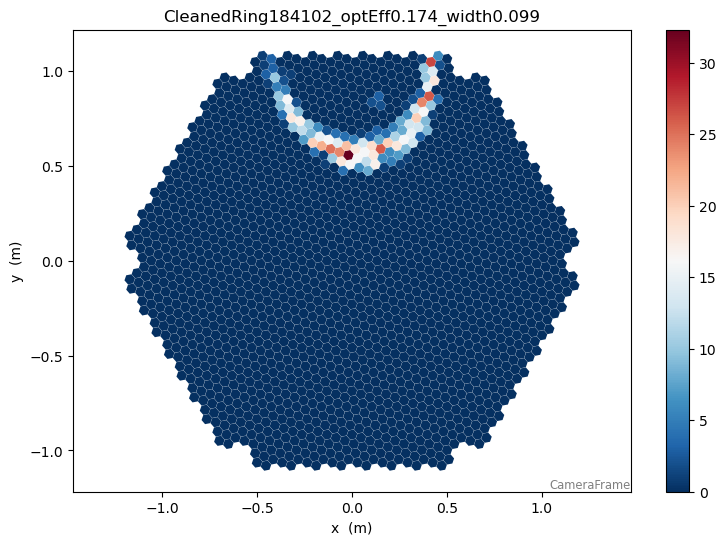

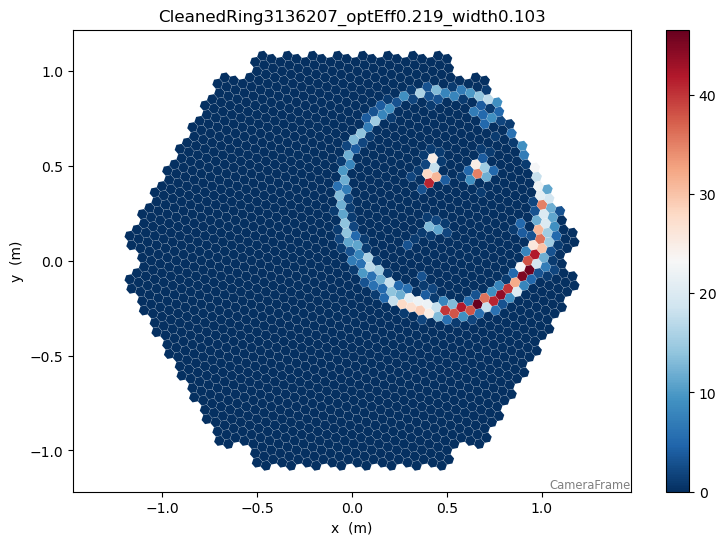

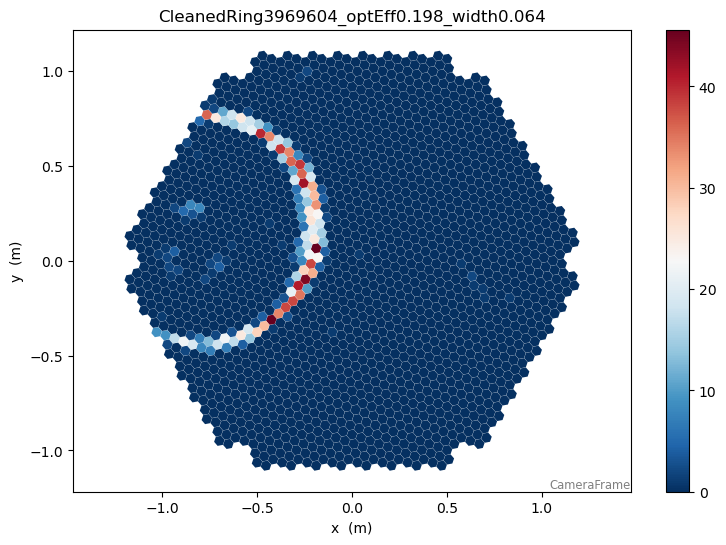

In [24]:
tels = 1
for event in muons:
    print(event.index.event_id)
    plt.figure(figsize = (9,6))
    camgeom = source.subarray.tel[tels].camera.geometry
    title=f"CleanedRing{event.index.event_id}_optEff{round(event.muon.tel[tels].efficiency.optical_efficiency,3)}_width{round(event.muon.tel[tels].efficiency.width.to_value(),3)}"
    disp = CameraDisplay(camgeom,title=title)
    disp.image = event.simulation.tel[tels].true_image
    disp.cmap = plt.cm.RdBu_r
    disp.add_colorbar()
    disp.set_limits_percent(95)
    #plt.show()

In [48]:
len(opt_eff)

28

0.0003

CRAB LST 1 hour (3 runs approx. 20 min each) OBSERVATIONS 

In [34]:
crab_obs_file_1 = '~/crab_obs/muons_LST-1.Run10880.fits'
crab_obs_file_2 = '~/crab_obs/muons_LST-1.Run10881.fits'
crab_obs_file_3 = '~/crab_obs/muons_LST-1.Run10882.fits'

hdul_crab_1 = fits.open(crab_obs_file_1)
hdul_crab_2 = fits.open(crab_obs_file_2)
hdul_crab_3 = fits.open(crab_obs_file_3)
hdul_crab_1.info()

Filename: /Users/vdk/crab_obs/muons_LST-1.Run10880.fits
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  PRIMARY       1 PrimaryHDU       4   ()      
  1                1 BinTableHDU     54   9124R x 23C   [K, D, K, E, E, D, D, D, D, L, D, D, D, D, D, D, D, D, D, K, D, K, K]   


In [38]:
len(hdul_crab_1[1].data)

9124

In [36]:
len(hdul_crab_2[1].data)

9021

In [37]:
len(hdul_crab_3[1].data)

8809

In [49]:
len(hdul_crab_1[1].data) + len(hdul_crab_2[1].data) + len(hdul_crab_3[1].data)

26954

In [53]:
flag_count = 0
for flag in hdul_crab_1[1].data:
    if flag:
        flag_count += 1

In [54]:
flag_count

9124

In [35]:
filename1 = '/Users/vdk/energies_500.txt'
fi1 = open(filename1,'r')
lines = fi1.readlines() 
splitted = lines[0].split(',')
energies_proton_1 = np.array(list(filter(None, splitted))).astype('float')
fi1.close()

filename1 = '/Users/vdk/energies_501-1100.txt'
fi1 = open(filename1,'r')
lines = fi1.readlines() 
splitted = lines[0].split(',')
energies_proton_2 = np.array(list(filter(None, splitted))).astype('float')
fi1.close()

filename1 = '/Users/vdk/energies_625-1100.txt'
fi1 = open(filename1,'r')
lines = fi1.readlines() 
splitted = lines[0].split(',')
energies_proton_3 = np.array(list(filter(None, splitted))).astype('float')
fi1.close()

energies_proton = np.append(energies_proton_1, energies_proton_2)
energies_proton = np.append(energies_proton, energies_proton_3)

filename2 = '/Users/vdk/energies_for_filerange1-1100.txt'
fi2 = open(filename2, 'r')
lines = fi2.readlines()
energies_muon = np.array(lines).astype('float')



w_protons = sum([energy**(-0.7) for energy in energies_proton])
new_proton_sample = len(energies_proton)/ w_protons  * len(energies_proton)
new_proton_sample = w_protons

print("Initial proton sample size = ", len(energies_proton))
print("Weighted proton sample size = ", new_proton_sample)

w_muons = sum([energy**(-0.7) for energy in energies_muon])
new_muon_sample = len(energies_muon)/ w_muons * len(energies_muon)
new_muon_sample = w_muons

print("Initial muon sample size = ", len(energies_muon))
print("Weighted muon sample size = ", new_muon_sample)

print("Initial relation between muon sample size and proton sample = ", len(energies_muon)/len(energies_proton))
print("Weighed relation between muon sample size and proton sample = ", new_muon_sample / new_proton_sample)

print("reweigth muons = ", w_muons / len(energies_muon))
print("reweigth protons = ", w_protons / len(energies_proton))

Initial proton sample size =  277639
Weighted proton sample size =  746307.7686231183
Initial muon sample size =  329
Weighted muon sample size =  1104.3087460375184
Initial relation between muon sample size and proton sample =  0.0011849920220141984
Weighed relation between muon sample size and proton sample =  0.0014796961688806818
reweigth muons =  3.3565615381079588
reweigth protons =  2.6880509172814997


(array([1.33231e+05, 8.92600e+03, 3.99600e+03, 2.37600e+03, 1.70800e+03,
        1.14600e+03, 8.73000e+02, 7.34000e+02, 5.47000e+02, 4.63000e+02,
        4.04000e+02, 3.36000e+02, 2.93000e+02, 2.15000e+02, 2.10000e+02,
        2.34000e+02, 1.68000e+02, 1.51000e+02, 1.65000e+02, 1.15000e+02,
        1.36000e+02, 1.09000e+02, 1.22000e+02, 8.50000e+01, 8.70000e+01,
        7.70000e+01, 8.30000e+01, 5.70000e+01, 6.30000e+01, 5.20000e+01]),
 array([1.10431500e-02, 3.69044189e+00, 7.36984063e+00, 1.10492394e+01,
        1.47286381e+01, 1.84080369e+01, 2.20874356e+01, 2.57668343e+01,
        2.94462331e+01, 3.31256318e+01, 3.68050306e+01, 4.04844293e+01,
        4.41638280e+01, 4.78432268e+01, 5.15226255e+01, 5.52020243e+01,
        5.88814230e+01, 6.25608217e+01, 6.62402205e+01, 6.99196192e+01,
        7.35990180e+01, 7.72784167e+01, 8.09578154e+01, 8.46372142e+01,
        8.83166129e+01, 9.19960117e+01, 9.56754104e+01, 9.93548091e+01,
        1.03034208e+02, 1.06713607e+02, 1.10393005e+02])

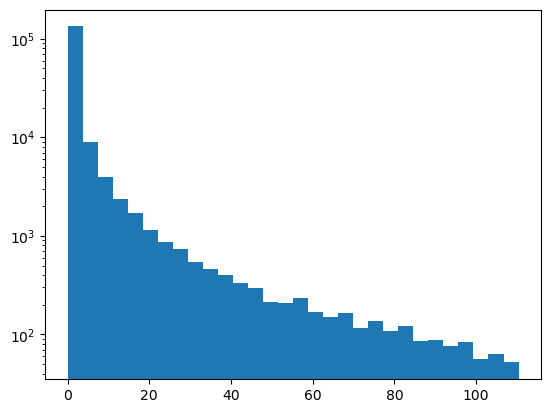

In [29]:
plt.hist(energies_proton, log=True, bins = 30)

(array([4.3732e+04, 2.8609e+04, 2.1401e+04, 1.5778e+04, 1.1926e+04,
        8.6040e+03, 6.6230e+03, 4.9960e+03, 3.6180e+03, 2.7880e+03,
        2.0990e+03, 1.5610e+03, 1.2560e+03, 9.6400e+02, 7.2200e+02,
        5.6400e+02, 4.3800e+02, 3.4300e+02, 2.4100e+02, 1.9800e+02,
        1.5300e+02, 1.2200e+02, 9.6000e+01, 9.2000e+01, 6.4000e+01,
        5.5000e+01, 3.4000e+01, 2.9000e+01, 2.5000e+01, 3.1000e+01]),
 array([ 0.03714847,  0.81702283,  1.59689718,  2.37677154,  3.1566459 ,
         3.93652026,  4.71639462,  5.49626898,  6.27614334,  7.05601769,
         7.83589205,  8.61576641,  9.39564077, 10.17551513, 10.95538949,
        11.73526384, 12.5151382 , 13.29501256, 14.07488692, 14.85476128,
        15.63463564, 16.41450999, 17.19438435, 17.97425871, 18.75413307,
        19.53400743, 20.31388179, 21.09375614, 21.8736305 , 22.65350486,
        23.43337922]),
 <BarContainer object of 30 artists>)

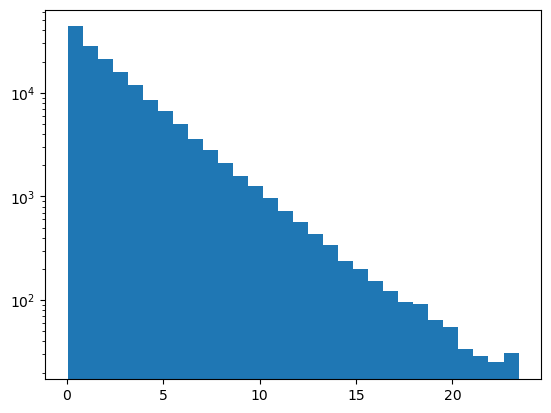

In [30]:
plt.hist([energy**(-0.7) for energy in energies_proton], log=True, bins = 30)

(array([101., 102.,  61.,  23.,  22.,   8.,   5.,   2.,   3.,   2.]),
 array([ 0.05938391,  1.68307414,  3.30676438,  4.93045461,  6.55414484,
         8.17783507,  9.80152531, 11.42521554, 13.04890577, 14.672596  ,
        16.29628624]),
 <BarContainer object of 10 artists>)

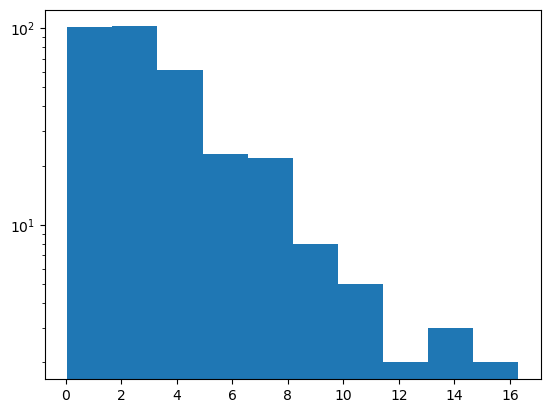

In [26]:
plt.hist([energy**(-0.7) for energy in energies_muon], log=True, bins = 10)

(array([319.,   4.,   2.,   0.,   0.,   0.,   1.,   0.,   0.,   3.]),
 array([1.85543094e-02, 5.66479039e+00, 1.13110265e+01, 1.69572625e+01,
        2.26034986e+01, 2.82497347e+01, 3.38959708e+01, 3.95422068e+01,
        4.51884429e+01, 5.08346790e+01, 5.64809151e+01]),
 <BarContainer object of 10 artists>)

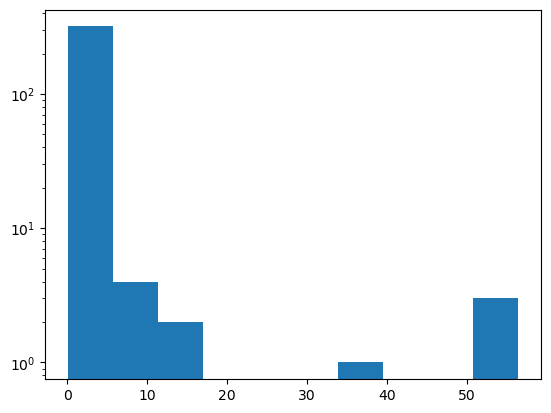

In [28]:
plt.hist(energies_muon, log=True, bins = 10)

In [34]:
filename1 = '/Users/vdk/energies_500.txt'
fi1 = open(filename1,'r')
lines = fi1.readlines() 
splitted = lines[0].split(',')
energies_proton = np.array(list(filter(None, splitted))).astype('float')
fi1.close()

filename2 = '/Users/vdk/energies_for_filerange1-499.txt
fi2 = open(filename2, 'r')
lines = fi2.readlines()
energies_muon = np.array(lines).astype('float')



w_protons = sum([energy**(-0.7) for energy in energies_proton])
new_proton_sample = len(energies_proton)/ w_protons  * len(energies_proton)
new_proton_sample = w_protons

print("Initial proton sample size = ", len(energies_proton))
print("Weighted proton sample size = ", new_proton_sample)

w_muons = sum([energy**(-0.7) for energy in energies_muon])
new_muon_sample = len(energies_muon)/ w_muons * len(energies_muon)
new_muon_sample = w_muons

print("Initial muon sample size = ", len(energies_muon))
print("Weighted muon sample size = ", new_muon_sample)

print("Initial relation between muon sample size and proton sample = ", len(energies_muon)/len(energies_proton))
print("Weighed relation between muon sample size and proton sample = ", new_muon_sample / new_proton_sample)

print("reweigth muons = ", w_muons / len(energies_muon))
print("reweigth protons = ", w_protons / len(energies_proton))

Initial proton sample size =  126300
Weighted proton sample size =  339424.48359679186
Initial muon sample size =  151
Weighted muon sample size =  510.53927863089604
Initial relation between muon sample size and proton sample =  0.0011955661124307205
Weighed relation between muon sample size and proton sample =  0.0015041321510482855
reweigth muons =  3.3810548253701724
reweigth protons =  2.687446425944512
